# Техническое задание: Маркетинг

## Описание
Интернет-магазин собирает историю покупок клиентов, проводит рассылки предложений и планирует будущие продажи. Для оптимизации процессов необходимо выделить пользователей, которые готовы совершить покупку в ближайшее время.

## Цель
Предсказать вероятность покупки в течение 90 дней.

## Задачи
1. Изучить данные.
2. Разработать полезные признаки.
3. Создать модель для классификации пользователей.
4. Улучшить модель и максимизировать метрику `roc_auc`.
5. Выполнить тестирование.

## Данные

### `apparel-purchases`
История покупок:
- `client_id` — идентификатор пользователя.
- `quantity` — количество товаров в заказе.
- `price` — цена товара.
- `category_ids` — вложенные категории, к которым относится товар.
- `date` — дата покупки.
- `message_id` — идентификатор сообщения из рассылки.

### `apparel-messages`
История рекламных рассылок:
- `bulk_campaign_id` — идентификатор рекламной кампании.
- `client_id` — идентификатор пользователя.
- `message_id` — идентификатор сообщений.
- `event` — тип действия.
- `channel` — канал рассылки.
- `date` — дата рассылки.
- `created_at` — точное время создания сообщения.

### `apparel-target_binary`
Совершит ли клиент покупку в течение следующих 90 дней:
- `client_id` — идентификатор пользователя.
- `target` — целевой признак.

### `full_campaign_daily_event.csv`
Агрегация общей базы рассылок по дням и типам событий:
- `date` — дата.
- `bulk_campaign_id` — идентификатор рассылки.
- `count_event` — общее количество каждого события `event`.
- `nunique_event` — количество уникальных `client_id` в каждом событии.

### `full_campaign_daily_event_channel.csv`
Агрегация по дням с учетом событий и каналов рассылки:
- `date` — дата.
- `bulk_campaign_id` — идентификатор рассылки.
- `count_event_channel` — общее количество каждого события по каналам.
- `nunique_event_channel` — количество уникальных `client_id` по событиям и каналам.

## План работы
1. **Исследование данных**:
   - Загрузка данных.
   - Предварительный анализ данных (пропуски, дубликаты, распределения).

2. **Разработка признаков**:
   - Создание новых признаков на основе имеющихся данных.
   - Анализ и отбор наиболее значимых признаков.

3. **Создание модели**:
   - Разделение данных на обучающую и тестовую выборки.
   - Выбор алгоритма машинного обучения.
   - Обучение модели.

4. **Оптимизация модели**:
   - Настройка гиперпараметров.
   - Улучшение метрики `roc_auc`.

5. **Тестирование**:
   - Оценка модели на тестовой выборке.
   - Анализ результатов.

6. **Заключение**:
   - Выводы по результатам работы.
   - Рекомендации по дальнейшим действиям.

### Импорты, глобальные функции и переменные

In [154]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import ast
import phik
import optuna


from sklearn.model_selection import train_test_split
# from imblearn.over_sampling import SMOTE
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from category_encoders import TargetEncoder
from xgboost import XGBClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer, roc_auc_score
from sklearn.preprocessing import MinMaxScaler, MultiLabelBinarizer

In [155]:
RANDOM_STATE = 666


sns.set_theme(style="whitegrid")
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'
plt.rcParams['font.size'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['legend.title_fontsize'] = 12
plt.rcParams['figure.figsize'] = (10, 6)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['lines.linewidth'] = 2
plt.rcParams['lines.markersize'] = 6
plt.rcParams['axes.grid'] = True
plt.rcParams['axes.axisbelow'] = True
plt.rcParams['axes.labelweight'] = 'bold'

In [156]:
def parse_list(list_str) -> list:
    """
    Преобразует строки вида "[1, 2, 3]" в списки [1, 2, 3].
    """
    return ast.literal_eval(list_str)


def viz_target_distribution(df, target_col):
    """
    Визуализирует распределение целевого признака.
    """
    plt.figure(figsize=(10, 6))
    ax = sns.countplot(data=df, x=target_col, hue=target_col, legend=False)
    for p in ax.patches:
        ax.annotate(f'{int(p.get_height())}', 
                    (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha='center', va='center', fontsize=12, color='black', xytext=(0, 10), 
                    textcoords='offset points')
    plt.title(f'Распределение целевого признака (target)')
    plt.xlabel('Класс')
    plt.ylabel('Количество объектов')
    plt.show()

def viz_num_features(df, columns):
    """
    Визуализирует числовые признаки с помощью boxplot и гистограммы.
    """
    fig, axes = plt.subplots(len(columns), 2, figsize=(15, len(columns) * 5))

    for i, col in enumerate(columns):
        sns.boxplot(data=df, x='target', y=col, hue='target', ax=axes[i, 0])
        sns.histplot(data=df, x=col, hue='target', ax=axes[i, 1], kde=True, stat='density', common_norm=False, bins=30)

    fig.tight_layout()
    plt.show()

def viz_cat_features(df, columns):
    """
    Визуализирует категориальные признаки с помощью countplot.
    """
    fig, axes = plt.subplots(len(columns), 1, figsize=(15, len(columns) * 5))

    for i, col in enumerate(columns):
        if df[col].unique().size > 30:
            top_categories = df[col].value_counts().head(30).index
            sns.countplot(data=df[df[col].isin(top_categories)], x=col, hue='target', ax=axes[i], order=top_categories)
        else:
            sns.countplot(data=df, x=col, hue='target', ax=axes[i])

    fig.tight_layout()
    plt.show()

def get_features_to_drop(phik_matrix, threshold=0.9) -> list:
    """
    На основе матрицы Phik определяет признаки с высокой корреляцией и возвращает список признаков для удаления.
    Оставляем только один из пары коррелирующих признаков, наиболее важный для целевого признака.
    """
    high_covariance_features = phik_matrix[phik_matrix > threshold].stack().reset_index()
    high_covariance_features = high_covariance_features[high_covariance_features['level_0'] != high_covariance_features['level_1']]
    display(high_covariance_features)
    
    features_to_drop = []
    for _, row in high_covariance_features.iterrows():
        feature_1, feature_2 = row['level_0'], row['level_1']
        
        corr_1 = abs(phik_matrix.loc[feature_1, 'target'])
        corr_2 = abs(phik_matrix.loc[feature_2, 'target'])
        
        if corr_1 > corr_2:
            features_to_drop.append(feature_2)
        else:
            features_to_drop.append(feature_1)

    features_to_drop = list(set(features_to_drop))
    print("Признаки для удаления:", features_to_drop)
    return features_to_drop

def preparare_splitted_transformed_data(X, y):
    """
    "Функция для подготовки данных к обучению модели. Числовые признаки не требуют преобразования,
    так как используется для обучения XGBoost."
    """
    categorical_features = X.select_dtypes(include='category').columns
    numerical_features = X.select_dtypes(include=['float64', 'int64']).columns

    low_cardinality_categorical = [col for col in categorical_features if X[col].nunique() <= 10]
    high_cardinality_categorical = [col for col in categorical_features if X[col].nunique() > 10]

    low_cardinality_transformer = OneHotEncoder(handle_unknown='ignore')
    high_cardinality_transformer = TargetEncoder()

    preprocessor = ColumnTransformer(
        transformers=[
            ('low_cardinality', low_cardinality_transformer, low_cardinality_categorical),
            ('high_cardinality', high_cardinality_transformer, high_cardinality_categorical),
            ('numerical', 'passthrough', numerical_features)
        ],
        remainder='drop'  # Удаляем неиспользуемые признаки
    )
    pipeline = Pipeline(steps=[
        ('preprocessor', preprocessor),
    ])

    transformed_data = pipeline.fit_transform(X, y)
    feature_names = pipeline.named_steps['preprocessor'].get_feature_names_out()
    transformed_data = pd.DataFrame(transformed_data, columns=feature_names, index=X.index)


    X_train, X_test, y_train, y_test = train_test_split(transformed_data, y, test_size=0.2, random_state=RANDOM_STATE, stratify=y)

    ### Применение встроенных средств XGBoost показало большую точность, чем SMOTE
    # X_train, y_train = SMOTE(random_state=RANDOM_STATE).fit_resample(X_train, y_train)

    print('Получена матрица размером:', X_train.shape)
    return X_train, y_train, X_test, y_test, pipeline

def objective(trial, X_train, y_train) -> float:
    """
    Определяет целевую функцию для оптимизации гиперпараметров модели XGBoost с помощью Optuna."
    """
    neg = len(y_train[y_train == 0])  # количество negative class
    pos = len(y_train[y_train == 1])  # количество positive class
    scale_pos_weight = neg / pos
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000, step=50),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3, log=True),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'gamma': trial.suggest_float('gamma', 0, 5),
        'reg_alpha': trial.suggest_float('reg_alpha', 0, 10),
        'reg_lambda': trial.suggest_float('reg_lambda', 0, 10),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        # 'device': 'cuda',
        'objective': 'binary:logistic',
        'eval_metric': 'logloss',
        'random_state': RANDOM_STATE,
        'scale_pos_weight': scale_pos_weight, ## Ввиду экстремального дисбаланса в классе, не используем, используем SMOTE
    }
    model = XGBClassifier(**params)
    scores = cross_val_score(
        model, 
        X_train,
        y_train,
        cv=5, 
        scoring=make_scorer(roc_auc_score)
    )
    return scores.mean()


### Исследование данных

#### Загрузка данных

In [157]:
apparel_purchases_df = pd.read_csv('filtered_data/apparel-purchases.csv', parse_dates=['date'], converters={'category_ids': parse_list})
apparel_messages_df = pd.read_csv('filtered_data/apparel-messages.csv', parse_dates=['date', 'created_at'])
apparel_target_df = pd.read_csv('filtered_data/apparel-target_binary.csv')
full_campaign_daily_event_df = pd.read_csv('filtered_data/full_campaign_daily_event.csv', parse_dates=['date'])
full_campaign_daily_event_channel_df = pd.read_csv('filtered_data/full_campaign_daily_event_channel.csv', parse_dates=['date'])

In [158]:
apparel_purchases_df.info()
apparel_purchases_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202208 entries, 0 to 202207
Data columns (total 6 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   client_id     202208 non-null  int64         
 1   quantity      202208 non-null  int64         
 2   price         202208 non-null  float64       
 3   category_ids  202208 non-null  object        
 4   date          202208 non-null  datetime64[ns]
 5   message_id    202208 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(2), object(2)
memory usage: 9.3+ MB


,client_id,quantity,price,category_ids,date,message_id
0,1515915625468169594,1,1999.0,"[4, 28, 57, 431]",2022-05-16,1515915625468169594-4301-627b661e9736d
1,1515915625468169594,1,2499.0,"[4, 28, 57, 431]",2022-05-16,1515915625468169594-4301-627b661e9736d
2,1515915625471138230,1,6499.0,"[4, 28, 57, 431]",2022-05-16,1515915625471138230-4437-6282242f27843
3,1515915625471138230,1,4999.0,"[4, 28, 244, 432]",2022-05-16,1515915625471138230-4437-6282242f27843
4,1515915625471138230,1,4999.0,"[4, 28, 49, 413]",2022-05-16,1515915625471138230-4437-6282242f27843


In [159]:
apparel_messages_df.info()
apparel_messages_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12739798 entries, 0 to 12739797
Data columns (total 7 columns):
 #   Column            Dtype         
---  ------            -----         
 0   bulk_campaign_id  int64         
 1   client_id         int64         
 2   message_id        object        
 3   event             object        
 4   channel           object        
 5   date              datetime64[ns]
 6   created_at        datetime64[ns]
dtypes: datetime64[ns](2), int64(2), object(3)
memory usage: 680.4+ MB


,bulk_campaign_id,client_id,message_id,event,channel,date,created_at
0,4439,1515915625626736623,1515915625626736623-4439-6283415ac07ea,open,email,2022-05-19,2022-05-19 00:14:20
1,4439,1515915625490086521,1515915625490086521-4439-62834150016dd,open,email,2022-05-19,2022-05-19 00:39:34
2,4439,1515915625553578558,1515915625553578558-4439-6283415b36b4f,open,email,2022-05-19,2022-05-19 00:51:49
3,4439,1515915625553578558,1515915625553578558-4439-6283415b36b4f,click,email,2022-05-19,2022-05-19 00:52:20
4,4439,1515915625471518311,1515915625471518311-4439-628341570c133,open,email,2022-05-19,2022-05-19 00:56:52


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49849 entries, 0 to 49848
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype
---  ------     --------------  -----
 0   client_id  49849 non-null  int64
 1   target     49849 non-null  int64
dtypes: int64(2)
memory usage: 779.0 KB


,client_id,target
0,1515915625468060902,0
1,1515915625468061003,1
2,1515915625468061099,0
3,1515915625468061100,0
4,1515915625468061170,0


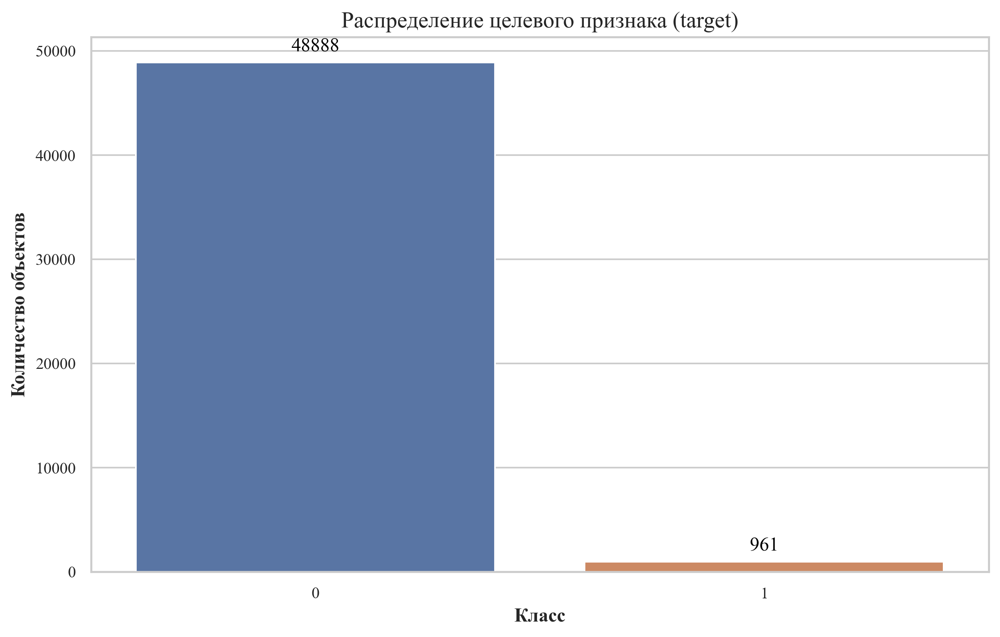

In [160]:
apparel_target_df.info()
display(apparel_target_df.head())
viz_target_distribution(apparel_target_df, 'target')

In [161]:
full_campaign_daily_event_df.info()
full_campaign_daily_event_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 131072 entries, 0 to 131071
Data columns (total 24 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   date                 131072 non-null  datetime64[ns]
 1   bulk_campaign_id     131072 non-null  int64         
 2   count_click          131072 non-null  int64         
 3   count_complain       131072 non-null  int64         
 4   count_hard_bounce    131072 non-null  int64         
 5   count_open           131072 non-null  int64         
 6   count_purchase       131072 non-null  int64         
 7   count_send           131072 non-null  int64         
 8   count_soft_bounce    131072 non-null  int64         
 9   count_subscribe      131072 non-null  int64         
 10  count_unsubscribe    131072 non-null  int64         
 11  nunique_click        131072 non-null  int64         
 12  nunique_complain     131072 non-null  int64         
 13  nunique_hard_b

,date,bulk_campaign_id,count_click,count_complain,count_hard_bounce,count_open,count_purchase,count_send,count_soft_bounce,count_subscribe,...,nunique_open,nunique_purchase,nunique_send,nunique_soft_bounce,nunique_subscribe,nunique_unsubscribe,count_hbq_spam,nunique_hbq_spam,count_close,nunique_close
0,2022-05-19,563,0,0,0,4,0,0,0,0,...,4,0,0,0,0,0,0,0,0,0
1,2022-05-19,577,0,0,0,1,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
2,2022-05-19,622,0,0,0,2,0,0,0,0,...,2,0,0,0,0,0,0,0,0,0
3,2022-05-19,634,0,0,0,1,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
4,2022-05-19,676,0,0,0,1,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0


In [162]:
full_campaign_daily_event_channel_df.info()
full_campaign_daily_event_channel_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 131072 entries, 0 to 131071
Data columns (total 36 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   date                             131072 non-null  datetime64[ns]
 1   bulk_campaign_id                 131072 non-null  int64         
 2   count_click_email                131072 non-null  int64         
 3   count_click_mobile_push          131072 non-null  int64         
 4   count_open_email                 131072 non-null  int64         
 5   count_open_mobile_push           131072 non-null  int64         
 6   count_purchase_email             131072 non-null  int64         
 7   count_purchase_mobile_push       131072 non-null  int64         
 8   count_soft_bounce_email          131072 non-null  int64         
 9   count_subscribe_email            131072 non-null  int64         
 10  count_unsubscribe_email          131072 non-

,date,bulk_campaign_id,count_click_email,count_click_mobile_push,count_open_email,count_open_mobile_push,count_purchase_email,count_purchase_mobile_push,count_soft_bounce_email,count_subscribe_email,...,count_send_email,nunique_hard_bounce_email,nunique_hbq_spam_email,nunique_send_email,count_soft_bounce_mobile_push,nunique_soft_bounce_mobile_push,count_complain_email,nunique_complain_email,count_close_mobile_push,nunique_close_mobile_push
0,2022-05-19,563,0,0,4,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2022-05-19,577,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2022-05-19,622,0,0,2,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2022-05-19,634,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2022-05-19,676,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [163]:
print('apparel purchases min/max date:', apparel_purchases_df['date'].min(), apparel_purchases_df['date'].max())
print('apparel messages min/max date:', apparel_messages_df['date'].min(), apparel_messages_df['date'].max())
print('bulk event min/max date:', full_campaign_daily_event_df['date'].min(), full_campaign_daily_event_df['date'].max())
print('bulk event channel min/max date:', full_campaign_daily_event_channel_df['date'].min(), full_campaign_daily_event_channel_df['date'].max())

apparel purchases min/max date: 2022-05-16 00:00:00 2024-02-16 00:00:00
apparel messages min/max date: 2022-05-19 00:00:00 2024-02-15 00:00:00
bulk event min/max date: 2022-05-19 00:00:00 2024-05-15 00:00:00
bulk event channel min/max date: 2022-05-19 00:00:00 2024-05-15 00:00:00


In [164]:
reference_date = apparel_purchases_df['date'].max()

#### Вывод.
Предоставленные данные соответствуют описанию. Присутствует сильный дисбалансов в классах искомого признака. Для подсчета сезонности используем максимальную представленную дату.

### Аггрегация таблиц

Данные содержат информацию о покупках и рекламных компаниях по дням. Для того, чтобы оценить вернется ли пользователь за покупками в течении близжайших 90 дней, эти данные предстоить агрегировать.

##### apparel-purchases

Из таблицы о покупках получаем следующие признаки:
- `first_purchase_date`  
  Дата первой совершенной покупки
- `last_purchase_date`  
  Дата последней зафиксированной покупки
- `days_since_last_purchase`  
  Количество дней, прошедших с момента последней покупки
- `activity_period`  
  Период активности (в днях): `last_purchase_date - first_purchase_date`
- `root_category`  
  Самая частая корневая категория (первый уровень категоризации товара)
- `target_category`  
  Самая частая целевая категория (конечный уровень категоризации товара)
- `purchased_total`  
  Общее количество купленных товаров
- `price_sum`  
  Суммарная стоимость всех покупок
- `messages_count`  
  Количество полученных рекламных сообщений

In [165]:
apparel_purchases_df['root_category'] = apparel_purchases_df['category_ids'].apply(lambda x: x[0] if (len(x) > 0 and x[0] != None) else 0).astype(int)
apparel_purchases_df['target_category'] = apparel_purchases_df['category_ids'].apply(lambda x: x[-1] if (len(x) > 0 and x[-1] != None) else 0).astype(int)

aggregated_apparel_purchases_df = apparel_purchases_df.groupby('client_id', as_index=False).agg(
    first_purchase_date=('date', 'min'),
    last_purchase_date=('date', 'max'),
    root_category=('root_category', lambda x: x.mode()[0] if not x.mode().empty else None),
    target_category=('target_category', lambda x: x.mode()[0] if not x.mode().empty else None),
    messages_count=('message_id', 'nunique')
)

aggregated_apparel_purchases_df['days_since_last_purchase'] = (reference_date - aggregated_apparel_purchases_df['last_purchase_date']).dt.days
aggregated_apparel_purchases_df['activity_period'] = (aggregated_apparel_purchases_df['last_purchase_date'] - aggregated_apparel_purchases_df['first_purchase_date']).dt.days
aggregated_apparel_purchases_df['purchased_total'] = apparel_purchases_df.groupby('client_id').size().values
aggregated_apparel_purchases_df['price_sum'] = apparel_purchases_df.groupby('client_id')['price'].sum().values
aggregated_apparel_purchases_df.head()

,client_id,first_purchase_date,last_purchase_date,root_category,target_category,messages_count,days_since_last_purchase,activity_period,purchased_total,price_sum
0,1515915625468060902,2022-05-27,2022-05-27,4,420,1,630,0,7,6993.0
1,1515915625468061003,2023-01-04,2023-01-04,4,615,1,408,0,7,16235.0
2,1515915625468061099,2022-05-17,2022-05-17,4,424,1,640,0,1,299.0
3,1515915625468061100,2024-02-10,2024-02-10,4,5717,1,6,0,2,2098.0
4,1515915625468061170,2023-03-26,2023-06-17,4,420,3,244,83,19,33601.0


##### apparel-messages

Данные о рекламных компаниях могут предоставить большое количество информации о поведении пользователя.

In [166]:
apparel_messages_df.head()

,bulk_campaign_id,client_id,message_id,event,channel,date,created_at
0,4439,1515915625626736623,1515915625626736623-4439-6283415ac07ea,open,email,2022-05-19,2022-05-19 00:14:20
1,4439,1515915625490086521,1515915625490086521-4439-62834150016dd,open,email,2022-05-19,2022-05-19 00:39:34
2,4439,1515915625553578558,1515915625553578558-4439-6283415b36b4f,open,email,2022-05-19,2022-05-19 00:51:49
3,4439,1515915625553578558,1515915625553578558-4439-6283415b36b4f,click,email,2022-05-19,2022-05-19 00:52:20
4,4439,1515915625471518311,1515915625471518311-4439-628341570c133,open,email,2022-05-19,2022-05-19 00:56:52


Разобьем данные по отрезкам в 90 дней для получения сезонных действий пользователя, начиная с самой первой представленной в данных дате.

In [167]:
start_date = pd.to_datetime("2022-05-16")
end_date = pd.to_datetime("2024-05-15")

date_ranges = []
current_date = start_date
while current_date <= end_date:
    date_ranges.append((current_date, current_date + pd.DateOffset(months=3)))
    current_date += pd.DateOffset(months=3)

date_ranges

[(Timestamp('2022-05-16 00:00:00'), Timestamp('2022-08-16 00:00:00')),
 (Timestamp('2022-08-16 00:00:00'), Timestamp('2022-11-16 00:00:00')),
 (Timestamp('2022-11-16 00:00:00'), Timestamp('2023-02-16 00:00:00')),
 (Timestamp('2023-02-16 00:00:00'), Timestamp('2023-05-16 00:00:00')),
 (Timestamp('2023-05-16 00:00:00'), Timestamp('2023-08-16 00:00:00')),
 (Timestamp('2023-08-16 00:00:00'), Timestamp('2023-11-16 00:00:00')),
 (Timestamp('2023-11-16 00:00:00'), Timestamp('2024-02-16 00:00:00')),
 (Timestamp('2024-02-16 00:00:00'), Timestamp('2024-05-16 00:00:00'))]

После общей агрегации признаков получаем:
- `bulks`  
  Уникальные рекламные кампании, которые охватили пользователя
- `bulk_coverage`  
  Общее количество рекламных кампаний, затрагивающих пользователя
- `bulk_email`  
  Количество кампаний, доставленных через **электронную почту**
- `bulk_phone`  
  Количество кампаний, доставленных через **мобильные уведомления**
- `bulk_positive_reaction`  
  Суммарный отклик:  
  `открытия + клики + покупки + подписки`
- `bulk_negative_reaction`  
  Суммарный негатив:  
  `жалобы + ошибки доставки + отписки + отметки "спам" + мгновенные закрытия` 
- `bulk_ignore_reaction`  
  Количество кампаний, на которые пользователь **не отреагировал** после доставки


In [168]:
positive_events = ['open', 'click', 'purchase', 'subscribe']
negative_events = ['complain', 'hard_bounce', 'soft_bounce', 'unsubscribe', 'hbq_spam', 'close']

apparel_messages_df['is_email'] = (apparel_messages_df['channel'] == 'email').astype(int)
apparel_messages_df['is_mobile'] = (apparel_messages_df['channel'] == 'mobile_push').astype(int)
apparel_messages_df['positive'] = apparel_messages_df['event'].isin(positive_events).astype(int)
apparel_messages_df['negative'] = apparel_messages_df['event'].isin(negative_events).astype(int)

aggregated_apparel_messages_df = apparel_messages_df.groupby('client_id', as_index=False).agg(
    bulks=('bulk_campaign_id', 'unique'),
    bulk_coverage=('bulk_campaign_id', 'nunique'),
    bulk_email=('is_email', 'sum'),
    bulk_phone=('is_mobile', 'sum'),
    bulk_positive_reaction=('positive', 'sum'),
    bulk_negative_reaction=('negative', 'sum')
)

sends = apparel_messages_df[apparel_messages_df['event'] == 'send'][['client_id', 'message_id']]
other_events = apparel_messages_df[apparel_messages_df['event'] != 'send']['message_id']
ignored_sends = sends[~sends['message_id'].isin(other_events)]
ignore_df = ignored_sends.groupby('client_id').size().reset_index(name='bulk_ignore_reaction')

aggregated_apparel_messages_df = aggregated_apparel_messages_df.merge(ignore_df, on='client_id', how='left')

aggregated_apparel_messages_df.fillna({
    'positive_reaction': 0,
    'negative_reaction': 0,
    'bulk_ignore_reaction': 0
}, inplace=True)

aggregated_apparel_messages_df['bulk_ignore_reaction'] = aggregated_apparel_messages_df['bulk_ignore_reaction'].astype(int)

aggregated_apparel_messages_df.head()

,client_id,bulks,bulk_coverage,bulk_email,bulk_phone,bulk_positive_reaction,bulk_negative_reaction,bulk_ignore_reaction
0,1515915625468060902,"[4463, 4568, 4591, 4617, 4439, 4679, 4696, 471...",127,177,0,50,1,94
1,1515915625468061003,"[4492, 4517, 4568, 4617, 4679, 4710, 4744, 496...",154,166,0,12,0,149
2,1515915625468061099,"[4463, 4568, 4591, 4617, 4679, 4696, 4744, 483...",215,182,94,59,2,164
3,1515915625468061100,"[4498, 4996, 5029, 5075, 5108, 5128, 5204, 523...",265,0,434,165,2,113
4,1515915625468061170,"[4568, 4617, 4679, 4744, 4981, 5052, 5184, 527...",240,202,91,50,0,212


In [169]:
aggregated_apparel_messages_df['client_id'].nunique()

53329

Клиентов в данных о рекламных компаниях больше чем в таблице с целевым признаком, разницу отделим после агрегации. Создадим сезонные признаки, которые отразят активность пользователей в каждый отрезок из 90 дней от первой до последней представленной даты. Сюда войдут:
- `sends_season_{N}`  
  Количество отправленных сообщений в сезоне *N*
- `opens_season_{N}`  
  Количество открытых сообщений в сезоне *N*
- `clicks_season_{N}`  
  Количество переходов по ссылкам в сезоне *N*
- `purchases_season_{N}`  
  Количество покупок после получения сообщения в сезоне *N*
- `subscribes_season_{N}`  
  Количество новых подписок в сезоне *N*
- `negative_season_{N}`  
  Количество негативных действий (отписки, жалобы) в сезоне *N*

In [170]:
apparel_messages_df['date'] = pd.to_datetime(apparel_messages_df['date'])
apparel_messages_df['season'] = -1

for i, (season_start, season_end) in enumerate(date_ranges):
    mask = (apparel_messages_df['date'] >= season_start) & (apparel_messages_df['date'] < season_end)
    apparel_messages_df.loc[mask, 'season'] = i + 1

seasonal_features = apparel_messages_df.groupby(['client_id', 'season']).agg(
    sends=('event', lambda x: (x == 'send').sum()),
    opens=('event', lambda x: (x == 'open').sum()),
    clicks=('event', lambda x: (x == 'click').sum()),
    purchases=('event', lambda x: (x == 'purchase').sum()),
    subscribes=('event', lambda x: (x == 'subscribe').sum()),
    negative=('event', lambda x: x.isin(negative_events).sum())
).reset_index()

seasonal_bulk_actions_features = pd.pivot_table(
    seasonal_features,
    index='client_id',
    columns='season',
    values=['sends', 'opens', 'clicks', 'purchases', 'subscribes', 'negative'],
    fill_value=0
)

seasonal_bulk_actions_features.columns = [f'{col[0]}_season_{col[1]}' for col in seasonal_bulk_actions_features.columns]
seasonal_bulk_actions_features.head()

,clicks_season_1,clicks_season_2,clicks_season_3,clicks_season_4,clicks_season_5,clicks_season_6,clicks_season_7,negative_season_1,negative_season_2,negative_season_3,...,sends_season_5,sends_season_6,sends_season_7,subscribes_season_1,subscribes_season_2,subscribes_season_3,subscribes_season_4,subscribes_season_5,subscribes_season_6,subscribes_season_7
client_id,,,,,,,,,,,,,,,,,,,,,
1515915625468060902,4.0,4.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,...,13.0,16.0,20.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061003,0.0,0.0,1.0,1.0,3.0,0.0,1.0,0.0,0.0,0.0,...,30.0,27.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061099,0.0,3.0,3.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,...,24.0,20.0,29.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061100,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,55.0,57.0,69.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061170,2.0,7.0,0.0,5.0,1.0,1.0,0.0,0.0,0.0,0.0,...,26.0,29.0,110.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [171]:
seasonal_bulk_actions_features.info()

<class 'pandas.core.frame.DataFrame'>
Index: 53329 entries, 1515915625468060902 to 1515915626010288690
Data columns (total 42 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   clicks_season_1      53329 non-null  float64
 1   clicks_season_2      53329 non-null  float64
 2   clicks_season_3      53329 non-null  float64
 3   clicks_season_4      53329 non-null  float64
 4   clicks_season_5      53329 non-null  float64
 5   clicks_season_6      53329 non-null  float64
 6   clicks_season_7      53329 non-null  float64
 7   negative_season_1    53329 non-null  float64
 8   negative_season_2    53329 non-null  float64
 9   negative_season_3    53329 non-null  float64
 10  negative_season_4    53329 non-null  float64
 11  negative_season_5    53329 non-null  float64
 12  negative_season_6    53329 non-null  float64
 13  negative_season_7    53329 non-null  float64
 14  opens_season_1       53329 non-null  float64
 15  opens_sea

#### campaign_daily_event

Из информации о рекламных компаниях, можем оценить насколько та или иная компания была успешной и приводила в покупкам.

In [172]:
full_campaign_daily_event_df.head()

,date,bulk_campaign_id,count_click,count_complain,count_hard_bounce,count_open,count_purchase,count_send,count_soft_bounce,count_subscribe,...,nunique_open,nunique_purchase,nunique_send,nunique_soft_bounce,nunique_subscribe,nunique_unsubscribe,count_hbq_spam,nunique_hbq_spam,count_close,nunique_close
0,2022-05-19,563,0,0,0,4,0,0,0,0,...,4,0,0,0,0,0,0,0,0,0
1,2022-05-19,577,0,0,0,1,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
2,2022-05-19,622,0,0,0,2,0,0,0,0,...,2,0,0,0,0,0,0,0,0,0
3,2022-05-19,634,0,0,0,1,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
4,2022-05-19,676,0,0,0,1,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0


Для начала соберем данные для каждой компании вместе.

In [173]:
aggregated_bulk_df = full_campaign_daily_event_df.groupby('bulk_campaign_id').agg(
    send=('count_send', 'sum'),
    open=('count_open', 'sum'),
    click=('count_click', 'sum'),
    purchase=('count_purchase', 'sum'),
    subscribe=('count_subscribe', 'sum'),
    unsubscribe=('count_unsubscribe', 'sum'),
    complain=('count_complain', 'sum'),
    hard_bounce=('count_hard_bounce', 'sum'),
    soft_bounce=('count_soft_bounce', 'sum'),
    hbq_spam=('count_hbq_spam', 'sum'),
    close=('count_close', 'sum')
).reset_index()

aggregated_bulk_df['positive_events'] = aggregated_bulk_df[positive_events].sum(axis=1)
aggregated_bulk_df['negative_events'] = aggregated_bulk_df[negative_events].sum(axis=1)

aggregated_bulk_df.head()

,bulk_campaign_id,send,open,click,purchase,subscribe,unsubscribe,complain,hard_bounce,soft_bounce,hbq_spam,close,positive_events,negative_events
0,548,0,5,0,0,0,0,0,0,0,0,0,5,0
1,563,0,49,37,1,0,0,6,0,0,0,0,87,6
2,577,0,133,0,0,0,7,4,0,0,0,0,133,11
3,585,0,51,9,0,0,0,3,0,0,0,0,60,3
4,594,0,44,2,0,0,0,5,0,0,0,0,46,5


Из этих данных получаем признаки в DataFrame `aggregated_bulk_df`

- **`purchase_rate`**  
  Коэффициент покупок:  
  `purchase / send` (заполняется 0 при NaN)
  
- **`ctr`** (Click-Through Rate)  
  Коэффициент кликов:  
  `click / send` (заполняется 0 при NaN)
  
- **`open_rate`**  
  Коэффициент открытий:  
  `open / send` (заполняется 0 при NaN)

- **`conversion_click_to_purchase`**  
  Конверсия из кликов в покупки:  
  `purchase / click` (заполняется 0 при NaN)

- **`positive_to_negative_ratio`**  
  Соотношение позитивных/негативных реакций (с smoothing `eps=1`):  
  `(positive_events + eps) / (negative_events + eps)`

- **`net_sentiment_score`**  
  Чистый сентимент:  
  `positive_events - negative_events`

- **`response_rate`**  
  Общий коэффициент отклика:  
  `(open + click + purchase) / send` (заполняется 0 при NaN)

- **`unsubscribe_rate`**  
  Коэффициент отписок:  
  `unsubscribe / send` (заполняется 0 при NaN)

- **Нормализованные признаки (MinMaxScaler)**:
  - `purchase_scaled` – нормализованное значение `purchase`
  - `ratio_scaled` – нормализованное значение `positive_to_negative_ratio`

- **`combined_score`**  
  Взвешенная комбинация:  
  `0.7 * purchase_scaled + 0.3 * ratio_scaled`

- Замена бесконечных значений (`np.inf`, `-np.inf`) на 0.


In [174]:
aggregated_bulk_df['purchase_rate'] = aggregated_bulk_df['purchase'] / aggregated_bulk_df['send']
aggregated_bulk_df['purchase_rate'] = aggregated_bulk_df['purchase_rate'].fillna(0)

eps = 1
aggregated_bulk_df['positive_to_negative_ratio'] = (aggregated_bulk_df['positive_events'] + eps) / (aggregated_bulk_df['negative_events'] + eps)
aggregated_bulk_df['net_sentiment_score'] = aggregated_bulk_df['positive_events'] - aggregated_bulk_df['negative_events']


aggregated_bulk_df['ctr'] = aggregated_bulk_df['click'] / aggregated_bulk_df['send']
aggregated_bulk_df['ctr'] = aggregated_bulk_df['ctr'].fillna(0)

aggregated_bulk_df['open_rate'] = aggregated_bulk_df['open'] / aggregated_bulk_df['send']
aggregated_bulk_df['open_rate'] = aggregated_bulk_df['open_rate'].fillna(0)

aggregated_bulk_df['conversion_click_to_purchase'] = aggregated_bulk_df['purchase'] / aggregated_bulk_df['click']
aggregated_bulk_df['conversion_click_to_purchase'] = aggregated_bulk_df['conversion_click_to_purchase'].fillna(0)

scaler = MinMaxScaler()
aggregated_bulk_df[['purchase_scaled', 'ratio_scaled']] = scaler.fit_transform(
    aggregated_bulk_df[['purchase', 'positive_to_negative_ratio']]
)
aggregated_bulk_df['combined_score'] = 0.7 * aggregated_bulk_df['purchase_scaled'] + 0.3 * aggregated_bulk_df['ratio_scaled']

aggregated_bulk_df['response_rate'] = (aggregated_bulk_df['open'] + aggregated_bulk_df['click'] + aggregated_bulk_df['purchase']) / aggregated_bulk_df['send']
aggregated_bulk_df['response_rate'] = aggregated_bulk_df['response_rate'].fillna(0)

aggregated_bulk_df['unsubscribe_rate'] = aggregated_bulk_df['unsubscribe'] / aggregated_bulk_df['send']
aggregated_bulk_df['unsubscribe_rate'] = aggregated_bulk_df['unsubscribe_rate'].fillna(0)


aggregated_bulk_df = aggregated_bulk_df.replace([np.inf, -np.inf], 0)


In [175]:
aggregated_bulk_df.head()

,bulk_campaign_id,send,open,click,purchase,subscribe,unsubscribe,complain,hard_bounce,soft_bounce,...,positive_to_negative_ratio,net_sentiment_score,ctr,open_rate,conversion_click_to_purchase,purchase_scaled,ratio_scaled,combined_score,response_rate,unsubscribe_rate
0,548,0,5,0,0,0,0,0,0,0,...,6.000000,5,0.0,0.0,0.000000,0.000000,0.002992,0.000898,0.0,0.0
1,563,0,49,37,1,0,0,6,0,0,...,12.571429,81,0.0,0.0,0.027027,0.000401,0.006270,0.002162,0.0,0.0
2,577,0,133,0,0,0,7,4,0,0,...,11.166667,122,0.0,0.0,0.000000,0.000000,0.005569,0.001671,0.0,0.0
3,585,0,51,9,0,0,0,3,0,0,...,15.250000,57,0.0,0.0,0.000000,0.000000,0.007606,0.002282,0.0,0.0
4,594,0,44,2,0,0,0,5,0,0,...,7.833333,41,0.0,0.0,0.000000,0.000000,0.003907,0.001172,0.0,0.0


##### Дополнение apparel-messages
Теперь зная информацию о компаниях, и в каких участвовал пользователь объединим данные.

In [176]:
# Разворачиваем список bulk-кампаний
df_exploded = aggregated_apparel_messages_df.explode("bulks")

# Соединяем с агрегированными данными кампаний
df_merged = df_exploded.merge(
    aggregated_bulk_df,
    left_on="bulks", 
    right_on="bulk_campaign_id", 
    how="left"
)

# Группируем по client_id и считаем статистики
agg_config = {
    "purchase_rate": ["mean", "max"],  # Средний и максимальный уровень покупок
    "positive_to_negative_ratio": "mean",  # Среднее соотношение
    "ctr": ["mean", "last"],  # Средний CTR и CTR последней кампании
    "net_sentiment_score": "sum",  # Суммарный сентимент
    "bulk_campaign_id": "count"  # Количество кампаний (если нужно перезаписать)
}

client_metrics = df_merged.groupby("client_id").agg(agg_config)
client_metrics.columns = ["_".join(col).strip() for col in client_metrics.columns]

# Переименовываем колонки для ясности
client_metrics = client_metrics.rename(columns={
    "purchase_rate_mean": "avg_purchase_rate",
    "purchase_rate_max": "max_purchase_rate",
    "positive_to_negative_ratio_mean": "avg_pos_neg_ratio",
    "ctr_mean": "avg_ctr",
    "ctr_last": "last_ctr",
    "net_sentiment_score_sum": "total_net_sentiment"
})

# Объединяем с исходным датафреймом
aggregated_apparel_messages_df = aggregated_apparel_messages_df.merge(client_metrics, on="client_id", how="left")

In [177]:
# Индекс эффективности кампаний (взвешенная сумма)
aggregated_apparel_messages_df["efficiency_score"] = (
    0.5 * aggregated_apparel_messages_df["avg_purchase_rate"] +
    0.3 * aggregated_apparel_messages_df["avg_ctr"] +
    0.2 * aggregated_apparel_messages_df["avg_pos_neg_ratio"]
)

# Индекс лояльности (на основе сентимента)
aggregated_apparel_messages_df["loyalty_score"] = (
    aggregated_apparel_messages_df["total_net_sentiment"] / aggregated_apparel_messages_df["bulk_coverage"]
).fillna(0)

In [178]:
# Бинарный признак: участвовал ли в "успешных" кампаниях (purchase_rate > X)
aggregated_apparel_messages_df["high_purchase_campaigns"] = (
    aggregated_apparel_messages_df["max_purchase_rate"] > aggregated_apparel_messages_df["avg_purchase_rate"].quantile(0.75)
).astype(int)

# Категория активности: низкая/средняя/высокая
aggregated_apparel_messages_df["activity_category"] = pd.cut(
    aggregated_apparel_messages_df["bulk_coverage"],
    bins=[0, 5, 20, np.inf],
    labels=["low", "medium", "high"]
)

In [179]:
# Создаем бинарные признаки для топ-10 самых частых кампаний
top_campaigns = aggregated_apparel_messages_df["bulks"].explode().value_counts().head(10).index.tolist()
mlb = MultiLabelBinarizer(classes=top_campaigns)
campaign_features = pd.DataFrame(
    mlb.fit_transform(aggregated_apparel_messages_df["bulks"]),
    columns=[f"campaign_{c}" for c in mlb.classes_]
)

aggregated_apparel_messages_df = pd.concat([aggregated_apparel_messages_df, campaign_features], axis=1)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\preprocessing\_label.py:909: UserWarning: unknown class(es) [np.int64(1001), np.int64(10020), np.int64(10022), np.int64(10028), np.int64(10029), np.int64(10036), np.int64(10037), np.int64(10043), np.int64(10060), np.int64(10061), np.int64(10064), np.int64(10065), np.int64(10067), np.int64(10070), np.int64(1011), np.int64(10114), np.int64(10127), np.int64(10129), np.int64(10130), np.int64(10145), np.int64(10146), np.int64(10152), np.int64(10159), np.int64(10179), np.int64(10180), np.int64(10186), np.int64(10187), np.int64(10193), np.int64(10194), np.int64(10195), np.int64(1020), np.int64(10209), np.int64(10210), np.int64(10218), np.int64(10233), np.int64(10234), np.int64(10235), np.int64(10247), np.int64(10248), np.int64(10256), np.int64(10257), np.int64(10268), np.int64(10269), np.int64(10270), np.int64(10289), np.int64(10308), np.int64(10309), np.int64(10321), np.int64(10326), np.int64(10329), np.int64(103

In [180]:
aggregated_apparel_messages_df.sample(1)

,client_id,bulks,bulk_coverage,bulk_email,bulk_phone,bulk_positive_reaction,bulk_negative_reaction,bulk_ignore_reaction,avg_purchase_rate,max_purchase_rate,...,campaign_4679,campaign_14623,campaign_14515,campaign_14081,campaign_13868,campaign_12218,campaign_14085,campaign_14376,campaign_9110,campaign_14641
25576,1515915625528416346,"[10690, 10685, 10795, 10936, 10962, 10990, 110...",210,0,430,217,0,7,0.000045,0.001775,...,0,1,1,1,0,0,0,0,0,0


Теперь мы знаем, как пользователь реагировал на рекламу и как она влияла на его покупательскую активность.

#### Объединение полученных данных

Для сохранения информации обо всех представленных пользователях данные объединяем при помощи outer join.

In [181]:
final_df = aggregated_apparel_messages_df.merge(aggregated_apparel_purchases_df, on='client_id', how='outer')
final_df = final_df.merge(seasonal_bulk_actions_features, on='client_id', how='left')
final_df = final_df.merge(apparel_target_df, on='client_id', how='outer')


final_df.set_index('client_id', inplace=True)
final_df['first_purchase_date'] = final_df['first_purchase_date'].astype('int64')
final_df['last_purchase_date'] = final_df['last_purchase_date'].astype('int64')
final_df[['root_category', 'target_category']] = final_df[['root_category', 'target_category']].astype('category')
final_df[[col for col in final_df.columns if 'campaign_' in col][1:]] = final_df[[col for col in final_df.columns if 'campaign_' in col][1:]].astype('category')
final_df = final_df.drop(columns=['bulks'])

final_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 61196 entries, 1515915625468060902 to 1515915626010443624
Data columns (total 79 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   bulk_coverage             53329 non-null  float64 
 1   bulk_email                53329 non-null  float64 
 2   bulk_phone                53329 non-null  float64 
 3   bulk_positive_reaction    53329 non-null  float64 
 4   bulk_negative_reaction    53329 non-null  float64 
 5   bulk_ignore_reaction      53329 non-null  float64 
 6   avg_purchase_rate         53329 non-null  float64 
 7   max_purchase_rate         53329 non-null  float64 
 8   avg_pos_neg_ratio         53329 non-null  float64 
 9   avg_ctr                   53329 non-null  float64 
 10  last_ctr                  53329 non-null  float64 
 11  total_net_sentiment       53329 non-null  float64 
 12  bulk_campaign_id_count    53329 non-null  float64 
 13  efficiency_score   

В итоге после объединения имеем 61196 уникальных id пользователей, что больше чем в датасете с целевым признаком. Разделим данные.

Первый датасет `no_purchases_clients` содержит в себе данные о рекламных компаниях и реакции 11347 пользователей на них, однако, для них нет информации о предыдущих покупках. После обучения моделей также оценим вероятность их покупок в ближайшие 90 дней.

In [182]:
no_purchases_clients = final_df[final_df['target'].isnull()]
no_purchases_clients.dropna(axis=1, how='all', inplace=True)
no_purchases_clients.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11347 entries, 1515915625468061899 to 1515915626010288690
Data columns (total 71 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   bulk_coverage            11347 non-null  float64 
 1   bulk_email               11347 non-null  float64 
 2   bulk_phone               11347 non-null  float64 
 3   bulk_positive_reaction   11347 non-null  float64 
 4   bulk_negative_reaction   11347 non-null  float64 
 5   bulk_ignore_reaction     11347 non-null  float64 
 6   avg_purchase_rate        11347 non-null  float64 
 7   max_purchase_rate        11347 non-null  float64 
 8   avg_pos_neg_ratio        11347 non-null  float64 
 9   avg_ctr                  11347 non-null  float64 
 10  last_ctr                 11347 non-null  float64 
 11  total_net_sentiment      11347 non-null  float64 
 12  bulk_campaign_id_count   11347 non-null  float64 
 13  efficiency_score         11347 non

C:\Users\User\AppData\Local\Temp\ipykernel_19880\3927743765.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  no_purchases_clients.dropna(axis=1, how='all', inplace=True)


В датасете `no_bulk_clients` содержится информация о предыдущих покупках 7867 пользователей и целевой признак, однако, совсем нет информации о рекламных компаниях. Построим отдельную модель для предсказания вероятности покупок подобных пользователей. 

In [183]:
no_bulk_clients = final_df[final_df['bulk_coverage'].isnull()]
no_bulk_clients = no_bulk_clients.dropna(axis=1)
no_bulk_clients.info()
no_bulk_clients.head()

<class 'pandas.core.frame.DataFrame'>
Index: 7867 entries, 1515915625468081882 to 1515915626010443624
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   first_purchase_date       7867 non-null   int64   
 1   last_purchase_date        7867 non-null   int64   
 2   root_category             7867 non-null   category
 3   target_category           7867 non-null   category
 4   messages_count            7867 non-null   float64 
 5   days_since_last_purchase  7867 non-null   float64 
 6   activity_period           7867 non-null   float64 
 7   purchased_total           7867 non-null   float64 
 8   price_sum                 7867 non-null   float64 
 9   target                    7867 non-null   float64 
dtypes: category(2), float64(6), int64(2)
memory usage: 598.4 KB


,first_purchase_date,last_purchase_date,root_category,target_category,messages_count,days_since_last_purchase,activity_period,purchased_total,price_sum,target
client_id,,,,,,,,,,
1515915625468081882,1671753600000000000,1671753600000000000,4.0,421.0,1.0,420.0,0.0,5.0,7924.0,0.0
1515915625468087979,1654300800000000000,1654300800000000000,4.0,841.0,1.0,622.0,0.0,13.0,2527.0,0.0
1515915625468093885,1654473600000000000,1684800000000000000,4.0,616.0,7.0,269.0,351.0,35.0,88432.0,1.0
1515915625468105189,1695859200000000000,1700784000000000000,4.0,548.0,2.0,84.0,57.0,7.0,8793.0,0.0
1515915625468122963,1654387200000000000,1654387200000000000,4.0,657.0,1.0,621.0,0.0,1.0,2399.0,0.0


Датасет `full_clients` содержит полную информацию об активности 41982 пользователей вместе с целевым признаком.

In [184]:
full_clients = final_df[~final_df['target'].isnull()]
full_clients.dropna(inplace=True)
full_clients.info()

<class 'pandas.core.frame.DataFrame'>
Index: 41982 entries, 1515915625468060902 to 1515915626010261344
Data columns (total 79 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   bulk_coverage             41982 non-null  float64 
 1   bulk_email                41982 non-null  float64 
 2   bulk_phone                41982 non-null  float64 
 3   bulk_positive_reaction    41982 non-null  float64 
 4   bulk_negative_reaction    41982 non-null  float64 
 5   bulk_ignore_reaction      41982 non-null  float64 
 6   avg_purchase_rate         41982 non-null  float64 
 7   max_purchase_rate         41982 non-null  float64 
 8   avg_pos_neg_ratio         41982 non-null  float64 
 9   avg_ctr                   41982 non-null  float64 
 10  last_ctr                  41982 non-null  float64 
 11  total_net_sentiment       41982 non-null  float64 
 12  bulk_campaign_id_count    41982 non-null  float64 
 13  efficiency_score   

C:\Users\User\AppData\Local\Temp\ipykernel_19880\1441288494.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_clients.dropna(inplace=True)


Сезонные признаки будем анализировать отдельно.

In [185]:
seasonal_columns = [col for col in final_df.columns if 'season' in col]

### Анализ полученных данных

#### Клиенты без информации о рекламных компаниях `no_bulk_clients`

<class 'pandas.core.frame.DataFrame'>
Index: 7867 entries, 1515915625468081882 to 1515915626010443624
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   first_purchase_date       7867 non-null   int64   
 1   last_purchase_date        7867 non-null   int64   
 2   root_category             7867 non-null   category
 3   target_category           7867 non-null   category
 4   messages_count            7867 non-null   float64 
 5   days_since_last_purchase  7867 non-null   float64 
 6   activity_period           7867 non-null   float64 
 7   purchased_total           7867 non-null   float64 
 8   price_sum                 7867 non-null   float64 
 9   target                    7867 non-null   float64 
dtypes: category(2), float64(6), int64(2)
memory usage: 598.4 KB


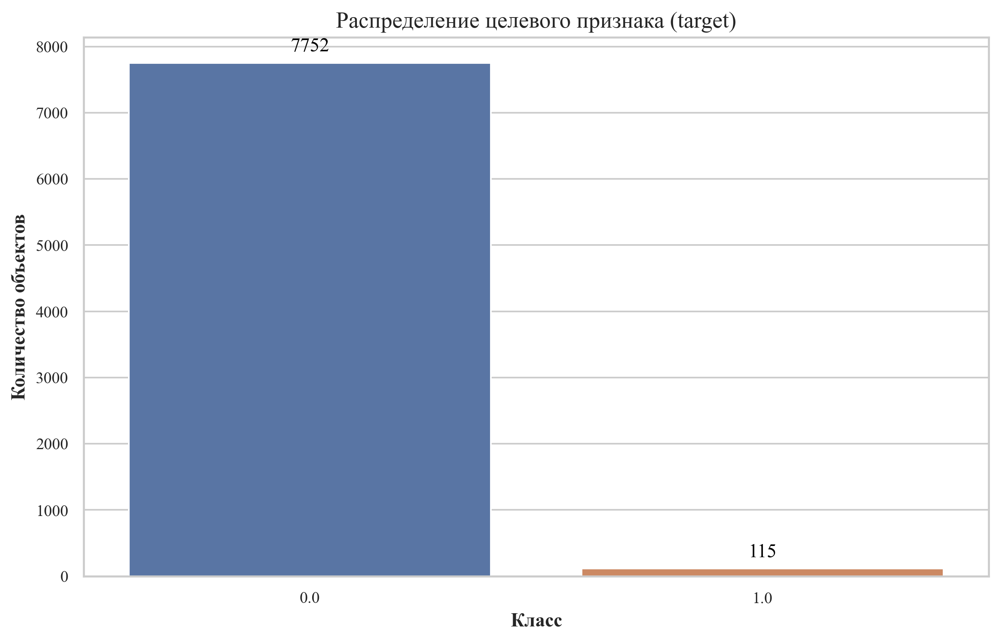

In [186]:
no_bulk_clients.info()
viz_target_distribution(no_bulk_clients, 'target')

Всего 115 из 7867 пользователей вернулись за покупками в течении 90 дней для `no_bulk_clients`.

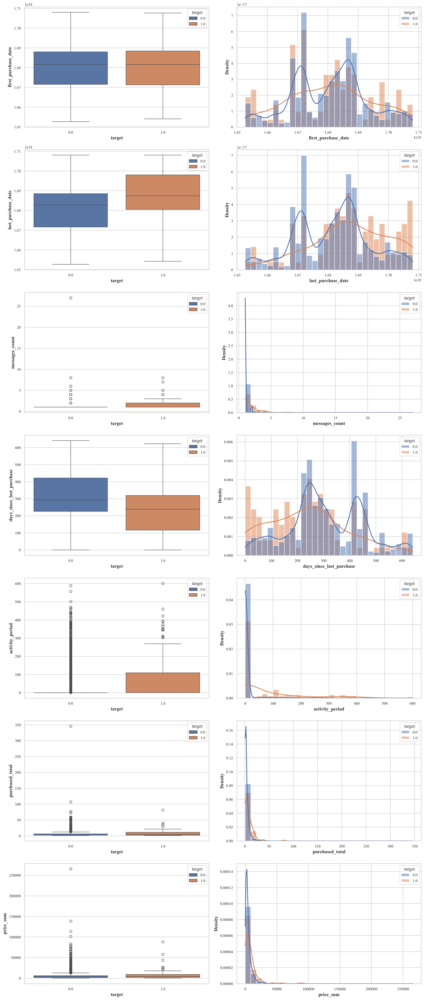

In [187]:
num_columns = no_bulk_clients.drop(columns=['root_category', 'target_category', 'target']).columns

viz_num_features(no_bulk_clients, num_columns)

Распределения числовых признаков далеки от нормальных. Влияние на целевой в большей степени оказывают период активности пользователя (если пользователь совершал несколько покупок в разное время, он скорее всего вернется) и количество полученных рекламных сообщений. Оценить какие именно компании имели на них эффект не получится.

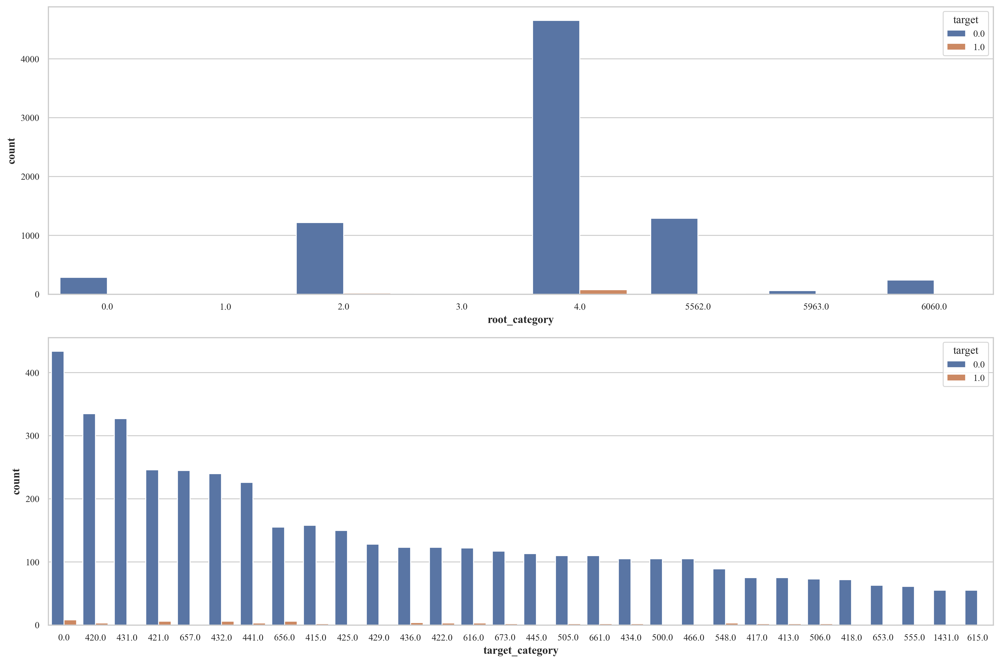

In [188]:
cat_columns = ['root_category', 'target_category']

viz_cat_features(no_bulk_clients, cat_columns)

Так как большинство данных представлено 4ой корневой категорией товаров, ее влияние незначительно, однако для целевых категорий 432, 421, 656, 0 количество положительных значений класса больше, чем для других.

#### Клиенты с полной информацией `full_clients`

In [189]:
full_clients.info()

<class 'pandas.core.frame.DataFrame'>
Index: 41982 entries, 1515915625468060902 to 1515915626010261344
Data columns (total 79 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   bulk_coverage             41982 non-null  float64 
 1   bulk_email                41982 non-null  float64 
 2   bulk_phone                41982 non-null  float64 
 3   bulk_positive_reaction    41982 non-null  float64 
 4   bulk_negative_reaction    41982 non-null  float64 
 5   bulk_ignore_reaction      41982 non-null  float64 
 6   avg_purchase_rate         41982 non-null  float64 
 7   max_purchase_rate         41982 non-null  float64 
 8   avg_pos_neg_ratio         41982 non-null  float64 
 9   avg_ctr                   41982 non-null  float64 
 10  last_ctr                  41982 non-null  float64 
 11  total_net_sentiment       41982 non-null  float64 
 12  bulk_campaign_id_count    41982 non-null  float64 
 13  efficiency_score   

In [190]:
num_columns = full_clients.drop(columns=seasonal_columns + ['target']).select_dtypes(exclude='category').columns

viz_num_features(full_clients, num_columns)

Дополнительные данные о рекламной активности не оказывают сильного влияния на целевой признак, и как для предыдущего датасета, наибольшее влияние оказывает период активности и количество рекламных сообщений. Однако дополнительные данные позволят повысит точность в определении класса, и их действительное значение оценим после построения моделей.

In [191]:
cat_columns = full_clients.select_dtypes(include='category').columns

viz_cat_features(full_clients, cat_columns)

Активность пользователя и некоторые успешные компании оказывают положительное влияние на оценку класса.

#### Сезонная активность пользователей

In [192]:
full_clients[seasonal_columns].info()
full_clients[seasonal_columns].head(10)

<class 'pandas.core.frame.DataFrame'>
Index: 41982 entries, 1515915625468060902 to 1515915626010261344
Data columns (total 42 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   clicks_season_1      41982 non-null  float64
 1   clicks_season_2      41982 non-null  float64
 2   clicks_season_3      41982 non-null  float64
 3   clicks_season_4      41982 non-null  float64
 4   clicks_season_5      41982 non-null  float64
 5   clicks_season_6      41982 non-null  float64
 6   clicks_season_7      41982 non-null  float64
 7   negative_season_1    41982 non-null  float64
 8   negative_season_2    41982 non-null  float64
 9   negative_season_3    41982 non-null  float64
 10  negative_season_4    41982 non-null  float64
 11  negative_season_5    41982 non-null  float64
 12  negative_season_6    41982 non-null  float64
 13  negative_season_7    41982 non-null  float64
 14  opens_season_1       41982 non-null  float64
 15  opens_sea

,clicks_season_1,clicks_season_2,clicks_season_3,clicks_season_4,clicks_season_5,clicks_season_6,clicks_season_7,negative_season_1,negative_season_2,negative_season_3,...,sends_season_5,sends_season_6,sends_season_7,subscribes_season_1,subscribes_season_2,subscribes_season_3,subscribes_season_4,subscribes_season_5,subscribes_season_6,subscribes_season_7
client_id,,,,,,,,,,,,,,,,,,,,,
1515915625468060902,4.0,4.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,...,13.0,16.0,20.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061003,0.0,0.0,1.0,1.0,3.0,0.0,1.0,0.0,0.0,0.0,...,30.0,27.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061099,0.0,3.0,3.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,...,24.0,20.0,29.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061100,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,55.0,57.0,69.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061170,2.0,7.0,0.0,5.0,1.0,1.0,0.0,0.0,0.0,0.0,...,26.0,29.0,110.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061514,6.0,2.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,...,12.0,25.0,28.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061877,2.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,4.0,60.0,71.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061975,3.0,0.0,2.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,...,28.0,21.0,18.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1515915625468061994,0.0,1.0,5.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,...,57.0,61.0,89.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


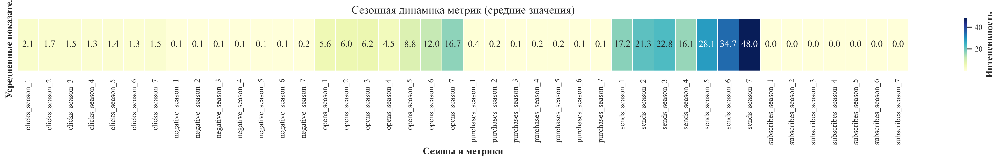

In [193]:
heatmap_data = full_clients[seasonal_columns].mean().to_frame().T  # Используем средние значения по всем клиентам

plt.figure(figsize=(20, 3))
sns.heatmap(
    heatmap_data,
    annot=True,
    fmt=".1f",
    cmap="YlGnBu",
    linewidths=.5,
    cbar_kws={'label': 'Интенсивность'}
)

plt.title('Сезонная динамика метрик (средние значения)')
plt.xlabel('Сезоны и метрики')
plt.ylabel('Усредненные показатели')
plt.xticks(rotation=90)
plt.yticks([])

plt.tight_layout()
plt.show()

Оценка сезонных средних позволяет заметить, что количество рассылок увеличивалось каждый сезон, однако это практически не повлияло на средние значения подписок и покупок. Это показывает, что, возможно, рекламные компании не очень эффективны, и следует пересмотреть их.

#### Phik критерий

interval columns not set, guessing: ['first_purchase_date', 'last_purchase_date', 'messages_count', 'days_since_last_purchase', 'activity_period', 'purchased_total', 'price_sum', 'target']


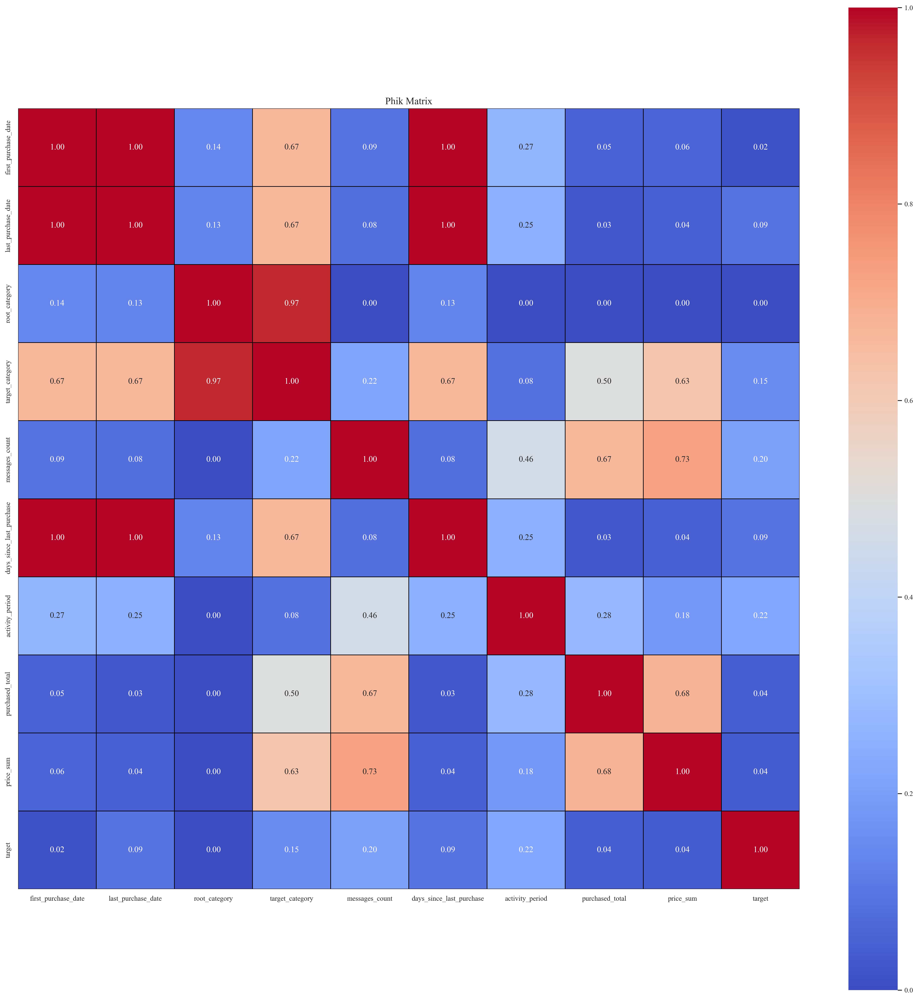

In [194]:
phik_matrix = no_bulk_clients.phik_matrix()

fig, ax = plt.subplots(figsize=(20, 20))
plt.title('Phik Matrix')
sns.heatmap(phik_matrix, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, square=True, ax=ax, linewidths=0.5, linecolor='black')
fig.tight_layout()
plt.show()

Наблюдаем мультиколлинеарность среди некоторых признаков, на целевой все представленные признаки оказывают слабое влияние. Наиболее значимый - activity_period.

In [195]:
features_to_drop = get_features_to_drop(phik_matrix, threshold=0.9)
no_bulk_clients = no_bulk_clients.drop(columns=features_to_drop)

,level_0,level_1,0
1,first_purchase_date,last_purchase_date,0.997928
2,first_purchase_date,days_since_last_purchase,0.997928
3,last_purchase_date,first_purchase_date,0.997928
5,last_purchase_date,days_since_last_purchase,1.000000
7,root_category,target_category,0.968356
8,target_category,root_category,0.968356
11,days_since_last_purchase,first_purchase_date,0.997928
12,days_since_last_purchase,last_purchase_date,1.000000


Признаки для удаления: ['last_purchase_date', 'root_category', 'first_purchase_date', 'days_since_last_purchase']


In [196]:
phik_matrix = full_clients.phik_matrix()

fig, ax = plt.subplots(figsize=(30, 30))
plt.title('Phik Matrix')
sns.heatmap(phik_matrix, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, square=True, ax=ax, linewidths=0.5, linecolor='black')
fig.tight_layout()
plt.show()

interval columns not set, guessing: ['bulk_coverage', 'bulk_email', 'bulk_phone', 'bulk_positive_reaction', 'bulk_negative_reaction', 'bulk_ignore_reaction', 'avg_purchase_rate', 'max_purchase_rate', 'avg_pos_neg_ratio', 'avg_ctr', 'last_ctr', 'total_net_sentiment', 'bulk_campaign_id_count', 'efficiency_score', 'loyalty_score', 'high_purchase_campaigns', 'first_purchase_date', 'last_purchase_date', 'messages_count', 'days_since_last_purchase', 'activity_period', 'purchased_total', 'price_sum', 'clicks_season_1', 'clicks_season_2', 'clicks_season_3', 'clicks_season_4', 'clicks_season_5', 'clicks_season_6', 'clicks_season_7', 'negative_season_1', 'negative_season_2', 'negative_season_3', 'negative_season_4', 'negative_season_5', 'negative_season_6', 'negative_season_7', 'opens_season_1', 'opens_season_2', 'opens_season_3', 'opens_season_4', 'opens_season_5', 'opens_season_6', 'opens_season_7', 'purchases_season_1', 'purchases_season_2', 'purchases_season_3', 'purchases_season_4', 'purcha

Как и с предыдущим датасетом, наблюдаем большое количество признаков с мультиколлинеарностью. На целевой, также все признаки влияют незначительно.

In [197]:
features_to_drop = get_features_to_drop(phik_matrix, threshold=0.9)
full_clients = full_clients.drop(columns=features_to_drop)

,level_0,level_1,0
1,bulk_coverage,bulk_campaign_id_count,1.000000
2,bulk_coverage,sends_season_4,0.960334
3,bulk_coverage,subscribes_season_5,0.941433
7,bulk_positive_reaction,opens_season_6,0.916396
8,bulk_positive_reaction,subscribes_season_5,0.941433
...,...,...,...
163,sends_season_7,campaign_14081,0.956257
169,subscribes_season_5,bulk_coverage,0.941433
170,subscribes_season_5,bulk_positive_reaction,0.941433
171,subscribes_season_5,bulk_campaign_id_count,0.941433


Признаки для удаления: ['campaign_12218', 'opens_season_6', 'total_net_sentiment', 'campaign_14515', 'efficiency_score', 'bulk_campaign_id_count', 'days_since_last_purchase', 'first_purchase_date', 'campaign_14085', 'campaign_14623', 'bulk_coverage', 'campaign_14081', 'subscribes_season_5', 'sends_season_4', 'campaign_14376', 'campaign_13868', 'root_category', 'bulk_ignore_reaction', 'sends_season_5', 'last_purchase_date', 'sends_season_2', 'campaign_14641']


### Построение моделей

#### Клиенты без информации о рекламных компаниях `no_bulk_clients`

In [198]:
no_bulk_clients.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7867 entries, 1515915625468081882 to 1515915626010443624
Data columns (total 6 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   target_category  7867 non-null   category
 1   messages_count   7867 non-null   float64 
 2   activity_period  7867 non-null   float64 
 3   purchased_total  7867 non-null   float64 
 4   price_sum        7867 non-null   float64 
 5   target           7867 non-null   float64 
dtypes: category(1), float64(5)
memory usage: 406.0 KB


В результате всех преобразований получаем 5 признаков.

In [199]:
X, y = no_bulk_clients.drop(columns=['target']), no_bulk_clients['target']

X_train, y_train, X_test, y_test, pipeline = preparare_splitted_transformed_data(X, y)

Получена матрица размером: (6293, 5)


In [200]:
study = optuna.create_study(direction='maximize')
study.optimize(lambda trial: objective(trial, X_train, y_train), n_trials=100, n_jobs=16)

print("Best parameters:", study.best_params)
print("Best roc_auc:", study.best_value)

[I 2025-04-02 16:18:47,387] A new study created in memory with name: no-name-21437081-d9e4-403f-a559-d61d8e7ba7f1
[I 2025-04-02 16:18:49,747] Trial 9 finished with value: 0.6925368706374255 and parameters: {'n_estimators': 100, 'max_depth': 6, 'learning_rate': 0.011222896739073987, 'subsample': 0.8520370689250498, 'colsample_bytree': 0.8285802739783019, 'gamma': 3.90929210033808, 'reg_alpha': 8.876641746243966, 'reg_lambda': 6.3995646874252765, 'min_child_weight': 9}. Best is trial 9 with value: 0.6925368706374255.
[I 2025-04-02 16:18:50,180] Trial 4 finished with value: 0.672273471427783 and parameters: {'n_estimators': 100, 'max_depth': 8, 'learning_rate': 0.012890837639030026, 'subsample': 0.7431274221185333, 'colsample_bytree': 0.812456869287205, 'gamma': 1.6339268550094177, 'reg_alpha': 6.728532546292207, 'reg_lambda': 7.305744965366929, 'min_child_weight': 6}. Best is trial 9 with value: 0.6925368706374255.
[I 2025-04-02 16:18:50,228] Trial 1 finished with value: 0.69865338112204

Best parameters: {'n_estimators': 300, 'max_depth': 3, 'learning_rate': 0.010145932045905304, 'subsample': 0.6848736747683147, 'colsample_bytree': 0.5014338769417093, 'gamma': 0.7100375067305837, 'reg_alpha': 9.421555092755348, 'reg_lambda': 4.575245689702492, 'min_child_weight': 9}
Best roc_auc: 0.7298578039568347


Проверим получившуюся модель на тестовой выборке.

In [201]:
model = XGBClassifier(**study.best_params)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test)[:, 1]

roc_auc = roc_auc_score(y_test, y_pred_proba)
print(f'Итоговый ROC-AUC на тестовой выборке: {roc_auc:.4f}')

Итоговый ROC-AUC на тестовой выборке: 0.8458


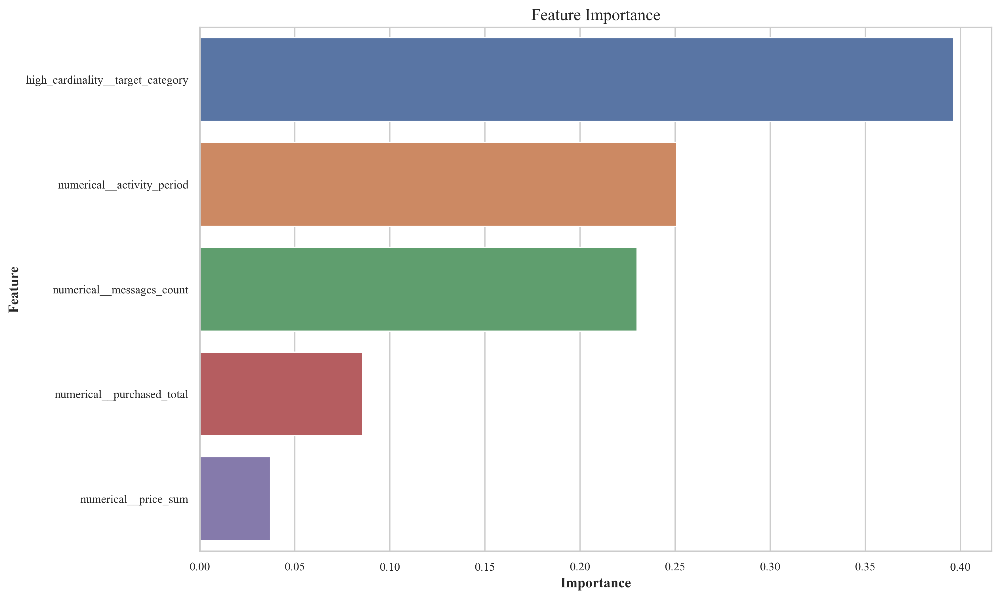

In [202]:
importances = model.feature_importances_
feature_names = pipeline.get_feature_names_out()  # Получение имен признаков из пайплайна

# Создаем DataFrame для удобства
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

# Визуализация
plt.figure(figsize=(12, 8))
sns.barplot(data=importance_df, x='Importance', y='Feature', hue='Feature', legend=False)
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

1. **`high_cardinality__target_category` (Важность: 0.3195)**  
   - **Главный фактор влияния**  
   - Целевая категория товаров (конечный уровень категоризации) критически важна для прогнозирования  
   - Интерпретация: Поведение пользователей сильно зависит от специфики товарных категорий

2. **`numerical__messages_count` (0.2564) & `numerical__activity_period` (0.2562)**  
   - **Сопутствующие важные факторы**  
   - Количество рекламных сообщений и период активности пользователя имеют почти равный вклад  
   - Паттерн: Чем дольше активность и больше коммуникаций → выше вовлеченность

3. **`numerical__purchased_total` (0.1679)**  
   - Количество покупок имеет ограниченное влияние  
   - Возможная причина: Уже частично объясняется другими признаками (категория + активность)

4. **`numerical__price_sum` (0.0)**  
   - Общая сумма покупок **не влияет** на прогноз  
   - Гипотезы:  
     ▸ Ценовой фактор нивелируется категорией товаров  
     ▸ Нет прямой связи суммы с целевой переменной  

#### Клиенты с полной информацией full_clients

In [203]:
X, y = full_clients.drop(columns=['target']), full_clients['target']

X_train, y_train, X_test, y_test, pipeline = preparare_splitted_transformed_data(X, y)

Получена матрица размером: (33585, 60)


In [204]:
study = optuna.create_study(direction='maximize')
study.optimize(lambda trial: objective(trial, X_train, y_train), n_trials=100, n_jobs=16)

# Лучшие параметры
print("Best parameters:", study.best_params)
print("Best roc_auc:", study.best_value)

[I 2025-04-02 16:19:27,235] A new study created in memory with name: no-name-c3ef0fe6-f119-4a70-96e4-b7cae00b29c8
[I 2025-04-02 16:19:40,695] Trial 0 finished with value: 0.566758072645214 and parameters: {'n_estimators': 100, 'max_depth': 9, 'learning_rate': 0.23784425614178753, 'subsample': 0.6363231604316218, 'colsample_bytree': 0.8951639339827748, 'gamma': 1.4130013103250731, 'reg_alpha': 7.931165664413376, 'reg_lambda': 6.770340632297106, 'min_child_weight': 3}. Best is trial 0 with value: 0.566758072645214.
[I 2025-04-02 16:19:42,876] Trial 12 finished with value: 0.6626630965812514 and parameters: {'n_estimators': 200, 'max_depth': 5, 'learning_rate': 0.055855989040416644, 'subsample': 0.7302335340394739, 'colsample_bytree': 0.5467789166548713, 'gamma': 3.0009613385375955, 'reg_alpha': 3.1251386010846183, 'reg_lambda': 1.3765142342191283, 'min_child_weight': 4}. Best is trial 12 with value: 0.6626630965812514.
[I 2025-04-02 16:19:45,063] Trial 9 finished with value: 0.6159564091

Best parameters: {'n_estimators': 750, 'max_depth': 3, 'learning_rate': 0.012772858554257485, 'subsample': 0.797674852239795, 'colsample_bytree': 0.9434526277270331, 'gamma': 1.8500306928900594, 'reg_alpha': 6.8188555861582305, 'reg_lambda': 4.993366520464576, 'min_child_weight': 2}
Best roc_auc: 0.7249595152668264


Оценим лучшую модель на тестовой выборке.

In [205]:
model = XGBClassifier(**study.best_params, objective='binary:logistic', eval_metric='logloss')
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test)[:, 1]

roc_auc = roc_auc_score(y_test, y_pred_proba)
print(f'Итоговый ROC-AUC на тестовой выборке: {roc_auc:.4f}')

Итоговый ROC-AUC на тестовой выборке: 0.8248


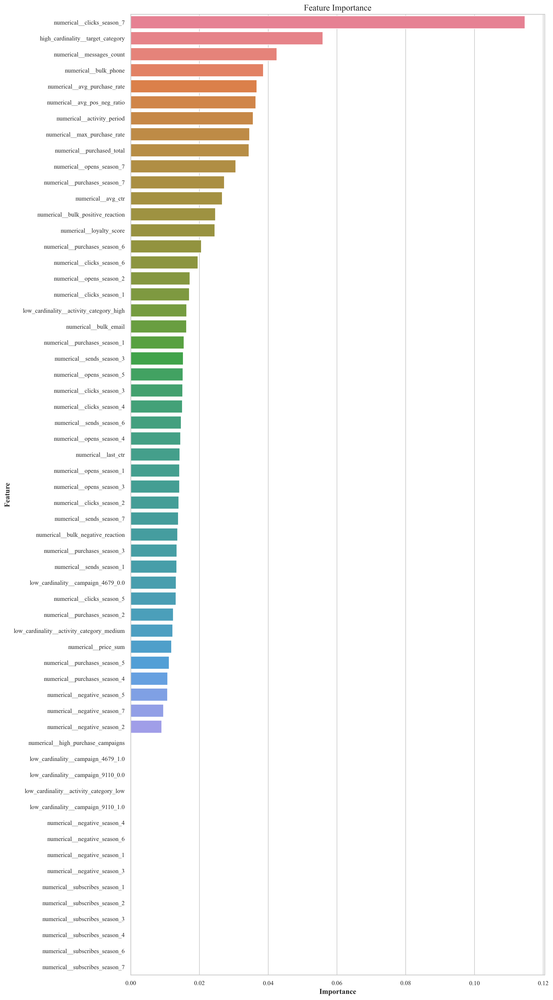

In [206]:
importances = model.feature_importances_
feature_names = pipeline.get_feature_names_out()  # Получение имен признаков из пайплайна

# Создаем DataFrame для удобства
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

# Визуализация
plt.figure(figsize=(12, 28))
sns.barplot(data=importance_df, x='Importance', y='Feature', hue='Feature', legend=False)
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

**Ключевые признаки модели**
1. **`numerical__clicks_season_7` (0.116)**  
   - **Самый влиятельный признак**  
   - Клики в 7-м сезоне (последнем временном отрезке) критически важны для прогноза  
   - Возможная интерпретация: **недавняя активность** пользователя сильнее влияет на целевую переменную

2. **`numerical__avg_ctr` (0.0777)**  
   - Средний CTR (click-through rate)  
   - Отражает **эффективность рекламных сообщений** в целом

3. **`high_cardinality__target_category` (0.0656)**  
   - Целевая категория товаров  
   - Подтверждает гипотезу о **категорийной сегментации** аудитории

---

**Вторичные значимые факторы**
| Признак | Важность | Интерпретация |
|---------|----------|---------------|
| `numerical__bulk_phone` | 0.0473 | **Мобильные каналы** доставки рекламы |
| `numerical__avg_pos_neg_ratio` | 0.0463 | Баланс позитивных/негативных реакций |
| `numerical__messages_count` | 0.0436 | Общее количество сообщений |
| `numerical__loyalty_score` | 0.0432 | Показатель лояльности клиента |

---

**Сезонные паттерны**
- **Сезон 7** доминирует в топе:  
  - `clicks_season_7` (1-е место)  
  - `purchases_season_7` (9-е место)  
  - `opens_season_7` (11-е место)  
- **Сезон 6**:  
  - `sends_season_6` (0.0238)  
  - `clicks_season_6` (0.0195)  

**Инсайт**: Активность в **последних сезонах** (6-7) имеет бóльший вес, чем в ранних.

---

**Низкая значимость**
- **Ценовые метрики**:  
  - `price_sum` (0.0087)  
  - `purchased_total` (0.0377)  
  - **Гипотеза**: Модель фокусируется на **поведенческих**, а не финансовых паттернах

- **Категории активности**:  
  - Все `low_cardinality__activity_category_*` = 0  
  - **Вывод**: Уровень активности не влияет на прогноз

---

**Неинформативные признаки**
1. **Подписки**:  
   Все `subscribes_season_*` = 0  
   **Инсайт**: Факт подписки не коррелирует с целевой переменной

2. **Негативные реакции**:  
   Все `negative_season_*` = 0  
   **Парадокс**: При этом `bulk_negative_reaction` имеет 0.012  
   **Гипотеза**: Суммарный негатив значим, но не его сезонное распределение

3. **Кампании**:  
   `low_cardinality__campaign_*` = 0  
   **Вывод**: Конкретные рекламные кампании не влияют на модель



#### Клиенты без информации о предыдущих покупках no_purchases_clients

Для предсказания вероятности покупки для таких клиентов, используем часть полных данных.

In [207]:
X, y = full_clients[full_clients.columns.intersection(no_purchases_clients.columns)], full_clients['target']

X_train, y_train, X_test, y_test, pipeline = preparare_splitted_transformed_data(X, y)

#Здесь нет смысла проводить тест, используем все данные для обучения
X_train = pd.concat([X_train, X_test], axis=0)
y_train = pd.concat([y_train, y_test], axis=0)

Получена матрица размером: (33585, 55)


In [208]:
study = optuna.create_study(direction='maximize')
study.optimize(lambda trial: objective(trial, X_train, y_train), n_trials=32, n_jobs=16)

model = XGBClassifier(**study.best_params, objective='binary:logistic', eval_metric='logloss')
model.fit(X_train, y_train)

[I 2025-04-02 16:24:27,211] A new study created in memory with name: no-name-fea6b630-45d9-4ebe-be64-10cca35587f7
[I 2025-04-02 16:24:39,168] Trial 4 finished with value: 0.6902575765013464 and parameters: {'n_estimators': 100, 'max_depth': 6, 'learning_rate': 0.015128007370071616, 'subsample': 0.8664341655253908, 'colsample_bytree': 0.9528220523134352, 'gamma': 1.1130244825837243, 'reg_alpha': 5.301212353743266, 'reg_lambda': 0.8602974501042893, 'min_child_weight': 6}. Best is trial 4 with value: 0.6902575765013464.
[I 2025-04-02 16:24:39,646] Trial 2 finished with value: 0.6518915666452891 and parameters: {'n_estimators': 200, 'max_depth': 3, 'learning_rate': 0.29281602521095945, 'subsample': 0.5271637075367483, 'colsample_bytree': 0.5086244100361259, 'gamma': 4.901950365633984, 'reg_alpha': 6.63816412007476, 'reg_lambda': 4.083266530364264, 'min_child_weight': 6}. Best is trial 4 with value: 0.6902575765013464.
[I 2025-04-02 16:24:40,299] Trial 12 finished with value: 0.571168761798

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.7904487095483215, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None,
              gamma=0.06566612566713736, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.011325745510373669,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=650, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [209]:
X = pipeline.transform(no_purchases_clients)

no_purchases_clients.loc[:, 'target'] = model.predict(X)
no_purchases_clients.loc[:, 'target_proba'] = model.predict_proba(X)[:, 1]
no_purchases_clients['target'].value_counts()

C:\Users\User\AppData\Local\Temp\ipykernel_19880\2440890344.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  no_purchases_clients.loc[:, 'target'] = model.predict(X)
C:\Users\User\AppData\Local\Temp\ipykernel_19880\2440890344.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  no_purchases_clients.loc[:, 'target_proba'] = model.predict_proba(X)[:, 1]


target
0    11347
Name: count, dtype: int64

In [210]:
# Клиенты с наибольшей вероятностью покупки
for ind in no_purchases_clients.sort_values(by='target_proba', ascending=False).head(10).index:
    print('Клиент id:', ind, 'Вероятность:', no_purchases_clients.loc[ind, 'target_proba'])


Клиент id: 1515915625629400136 Вероятность: 0.3089507
Клиент id: 1515915625589490008 Вероятность: 0.3083244
Клиент id: 1515915625582718602 Вероятность: 0.30088982
Клиент id: 1515915625553283230 Вероятность: 0.3006853
Клиент id: 1515915625798076756 Вероятность: 0.29098168
Клиент id: 1515915625566028933 Вероятность: 0.2823469
Клиент id: 1515915625468253138 Вероятность: 0.27475747
Клиент id: 1515915625564317398 Вероятность: 0.27460098
Клиент id: 1515915625554548878 Вероятность: 0.2707217
Клиент id: 1515915625651195207 Вероятность: 0.24767548


#### **Вывод** 

**Ключевая проблема: Низкая предсказательная сила модели**
1. **Экстремально низкие вероятности**:
   - Все предсказанные значения < 0.1% (0.0008-0.00083)
   - Даже "максимальная" вероятность (0.00087) соответствует 0.087%

**Возможные причины**
1. **Дефицит релевантных признаков**:
   - Данные только о рекламных взаимодействиях недостаточны для прогноза
   - Отсутствие связи с историей покупок → модель не находит паттерны конверсии

2. **Смещение выборки**:
   - Возможен сильный дисбаланс классов (подавляющее большинство клиентов не покупают)
   - Модель "страхуется" предсказанием низких вероятностей

3. **Проблемы с данными**:
   - Однотипное поведение всех клиентов в выборке
   - Неучтенные внешние факторы (сезонность, экономический контекст)

1. **Неэффективность текущего подхода**:
   - Рекламные метрики сами по себе не позволяют прогнозировать покупки
   - Требуется интеграция с данными о:
     - Демографии клиентов
     - Истории транзакций
     - Внешних событиях (акции, скидки)

2. **Риск ложных выводов**:
   - Различия между клиентами статистически незначимы
   - Модель фактически работает как "рандомизатор"

---
**Рекомендации**
1. **Улучшение данных**:
   - Добавить признаки из CRM-системы:
     - Lifetime Value (LTV)
     - Частота покупок
     - Средний чек
   - Внедрить трекинг мультиканальных взаимодействий

2. **Калибровка модели**:
   - Проверить баланс классов
   - Применить техники борьбы с дисбалансом:
     - SMOTE
     - Веса классов
     - Ансамблирование

3. **Эксперименты**:
   - Тестировать модели с учителем (CatBoost, LightGBM)
   - Добавить временные признаки:
     - Days since last activity
     - Purchase cycle patterns

4. **Валидация**:
   - Провести A/B тестирование прогнозов
   - Сравнить с baseline-моделью (например, предсказание среднего)


### **Вывод**

- **Данные о покупках**
    - Данные о покупках клиентов позволяют даже без данных о рекламных компаниях довольно точно определить, вернется ли клиент в следующем сезоне или нет;
    - Самыми важными критериями в таком случае будут период активности пользователя и количество полученных сообщений.
- **Полные данные**
    - Полные данные позволяют повысить точность прогноза;
    - В таком случаем самым важным признаком будет - активность клиента в последнем сезоне.
---
**Рекомендации**
1. Повысить качество данных, если данные о пользователях получающих рекламу, но не имеющих никакой информации о покупках получены в результате ошибки при хранении или выгрузке данных, это необходимо исправить;
2. Повысить качество рекламных компаний, интенсивность рассылки растет от сезона к сезону, однако это не сильно влияет на количество покупок;
3. Поощерять пользователей с ненулевым периодом активности.
